# Data Analysis final project for Ford GoBike Dataset
##### produced from Ford GoBike System the information in it talked about individual rides that were made in a bike-sharing system for covering San Francisco Bay area`

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

In [2]:
df=pd.read_csv('fordgobike-tripdataFor201902.csv')
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,52185,32:10.1,01:56.0,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No
1,42521,53:21.8,42:03.1,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,NaN,NaN,No
2,61854,13:13.2,24:08.1,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No
3,36490,54:26.0,02:36.8,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No
4,1585,54:18.5,20:44.1,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes


In [3]:
print(df.describe())
print(df.shape)

        duration_sec  start_station_id  start_station_latitude  \
count  183416.000000     183219.000000           183416.000000   
mean      726.067311        138.590365               37.771221   
std      1794.371831        111.778938                0.099586   
min        61.000000          3.000000               37.317298   
25%       325.000000         47.000000               37.770083   
50%       514.000000        104.000000               37.780760   
75%       796.000000        239.000000               37.797280   
max     85444.000000        398.000000               37.880222   

       start_station_longitude  end_station_id  end_station_latitude  \
count            183416.000000   183219.000000         183416.000000   
mean               -122.352661      136.249401             37.771425   
std                   0.117100      111.514916              0.099494   
min                -122.453705        3.000000             37.317298   
25%                -122.412408       44.00000

In [4]:
df.dtypes


duration_sec                 int64
start_time                  object
end_time                    object
start_station_id           float64
start_station_name          object
start_station_latitude     float64
start_station_longitude    float64
end_station_id             float64
end_station_name            object
end_station_latitude       float64
end_station_longitude      float64
bike_id                      int64
user_type                   object
member_birth_year          float64
member_gender               object
bike_share_for_all_trip     object
dtype: object

#### The structure of the dataset above contains 16 columns and 183416 rows and most variables are numeric

In [5]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183416 entries, 0 to 183415
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183416 non-null  int64  
 1   start_time               183416 non-null  object 
 2   end_time                 183416 non-null  object 
 3   start_station_id         183219 non-null  float64
 4   start_station_name       183219 non-null  object 
 5   start_station_latitude   183416 non-null  float64
 6   start_station_longitude  183416 non-null  float64
 7   end_station_id           183219 non-null  float64
 8   end_station_name         183219 non-null  object 
 9   end_station_latitude     183416 non-null  float64
 10  end_station_longitude    183416 non-null  float64
 11  bike_id                  183416 non-null  int64  
 12  user_type                183416 non-null  object 
 13  member_birth_year        175151 non-null  float64
 14  memb

In [6]:
df.isna().sum()


duration_sec                  0
start_time                    0
end_time                      0
start_station_id            197
start_station_name          197
start_station_latitude        0
start_station_longitude       0
end_station_id              197
end_station_name            197
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8265
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

#### member_birth_year and member_gender show many missing values as shown above

In [7]:
cols = ["end_station_id", "start_station_id", "start_station_name", 
        "end_station_name", "member_birth_year"]
for col in cols:
    df[col].fillna(df[col].mode()[0],inplace=True)

C:\Users\6y6yy\AppData\Local\Temp\ipykernel_5456\382230617.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mode()[0],inplace=True)


In [8]:
df.isna().sum()

duration_sec                  0
start_time                    0
end_time                      0
start_station_id              0
start_station_name            0
start_station_latitude        0
start_station_longitude       0
end_station_id                0
end_station_name              0
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year             0
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

In [9]:
#df.member_gender.head(10)
df['member_gender']=df["member_gender"].fillna('Male')

In [10]:
df.member_gender.head(10)


0      Male
1      Male
2      Male
3     Other
4      Male
5      Male
6    Female
7      Male
8     Other
9      Male
Name: member_gender, dtype: object

In [11]:
df.isna().sum()


duration_sec               0
start_time                 0
end_time                   0
start_station_id           0
start_station_name         0
start_station_latitude     0
start_station_longitude    0
end_station_id             0
end_station_name           0
end_station_latitude       0
end_station_longitude      0
bike_id                    0
user_type                  0
member_birth_year          0
member_gender              0
bike_share_for_all_trip    0
dtype: int64

#### as shown above, all missing values are gone


In [12]:
df.describe(include='object')


,start_time,end_time,start_station_name,end_station_name,user_type,member_gender,bike_share_for_all_trip
count,183416,183416,183416,183416,183416,183416,183416
unique,35783,35767,329,329,2,3,2
top,33:48.5,22:24.4,Market St at 10th St,San Francisco Caltrain Station 2 (Townsend St...,Subscriber,Male,No
freq,16,20,4101,5054,163548,138920,166056


#### create a feature 'age' to know the ages of the users

In [13]:
df['age'] = 2019 - df['member_birth_year']


In [14]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,age
0,52185,32:10.1,01:56.0,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No,35.0
1,42521,53:21.8,42:03.1,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,1988.0,Male,No,31.0
2,61854,13:13.2,24:08.1,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No,47.0
3,36490,54:26.0,02:36.8,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No,30.0
4,1585,54:18.5,20:44.1,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes,45.0


In [15]:
df.age=df.age.astype(int)

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183416 entries, 0 to 183415
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183416 non-null  int64  
 1   start_time               183416 non-null  object 
 2   end_time                 183416 non-null  object 
 3   start_station_id         183416 non-null  float64
 4   start_station_name       183416 non-null  object 
 5   start_station_latitude   183416 non-null  float64
 6   start_station_longitude  183416 non-null  float64
 7   end_station_id           183416 non-null  float64
 8   end_station_name         183416 non-null  object 
 9   end_station_latitude     183416 non-null  float64
 10  end_station_longitude    183416 non-null  float64
 11  bike_id                  183416 non-null  int64  
 12  user_type                183416 non-null  object 
 13  member_birth_year        183416 non-null  float64
 14  memb

In [17]:
df["duration_min"]=df["duration_sec"]/60
df["duration_min"]=df["duration_min"].astype(int)


#### changing our duration from seconds to min for an easier and more plain usage and we will add one for hours as well

In [18]:
df.duration_min.head(10)

0     869
1     708
2    1030
3     608
4      26
5      29
6      19
7      26
8      26
9      17
Name: duration_min, dtype: int64

In [19]:
df["duration_hour"]=(df["duration_sec"]/3600).round(2)
df.duration_hour.head()

0    14.50
1    11.81
2    17.18
3    10.14
4     0.44
Name: duration_hour, dtype: float64

# Now we will start our univariate research by analyzing one feature at a time
##### to better understand it

In [20]:
fig = px.histogram(
    df,
    x="user_type",
    color="user_type", 
    title="Distribution of user types in the dataset",
    labels={"user_type": "User Type"},
)
fig.update_layout(
    xaxis_title="User distribution",
    yaxis_title="Frequency",
    bargap=0.2,
    template="plotly_white"
)
fig.show()

In [21]:
fig = px.histogram(
    df,
    x="bike_share_for_all_trip",
    color="bike_share_for_all_trip", 
    title="Represent the user's distribution depending on being a part of the Trips Program"
)
fig.update_layout(
    xaxis_title="User distribution",
    yaxis_title="Frequency",
    bargap=0.2,
    template="plotly_white"
)
fig.show()

#### The histogram above is showing how many users said "Yes" vs how many said "No" to being part of the Bike Share for All Trip program.

In [22]:
df['age_bin'] = pd.cut(df['age'], bins=range(0, 100, 10), right=False)
labels = [str(interval) for interval in df['age_bin'].cat.categories]
fig = px.histogram(
    df,
    x="age",
    color="age_bin",
    category_orders={"age_bin": labels},
    title="Customer's Age distribution by Age Groups"
)
fig.show()

#### we will tey a diff plot to determine outliers

In [23]:
fig = px.box(
    df,
    x="age",
    title="Represent the user's Age distribution"
)
fig.update_layout(
    xaxis_title="User Age distribution",
    yaxis_title="Frequency",
    template="plotly_white"
)
fig.show()

#### the box plot shows outliers (ages >100)

In [24]:
df['duration_min'].describe().astype('int64')

count    183416
mean         11
std          29
min           1
25%           5
50%           8
75%          13
max        1424
Name: duration_min, dtype: int64

#### above are statistics for trips durations by minute

In [25]:
fig = px.histogram(
    df,
    x="duration_min",
    nbins=145,
    title=" Trip Duration in Minutes"
)
fig.update_xaxes(range=[0, 60], title="Duration in minutes")
fig.update_yaxes(title="Frequency")
fig.update_layout(template="plotly_white", bargap=0.05)
fig.show()

#### the majority of trips are 0-9 minutes long

In [26]:
fig = px.histogram(
    df,
    x="member_gender",
    title="Customers Distribution Depending on Their Member Gender"
)
fig.update_xaxes(title="User distribution")
fig.update_yaxes(title="Frequency")
fig.update_layout(template="plotly_white")
fig.show()

#### the majority of customers are males as shown above

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183416 entries, 0 to 183415
Data columns (total 20 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   duration_sec             183416 non-null  int64   
 1   start_time               183416 non-null  object  
 2   end_time                 183416 non-null  object  
 3   start_station_id         183416 non-null  float64 
 4   start_station_name       183416 non-null  object  
 5   start_station_latitude   183416 non-null  float64 
 6   start_station_longitude  183416 non-null  float64 
 7   end_station_id           183416 non-null  float64 
 8   end_station_name         183416 non-null  object  
 9   end_station_latitude     183416 non-null  float64 
 10  end_station_longitude    183416 non-null  float64 
 11  bike_id                  183416 non-null  int64   
 12  user_type                183416 non-null  object  
 13  member_birth_year        183416 non-null  fl

In [28]:
bin_require = [0,0.25,0.5,0.75 ,1]
counts, edges = np.histogram(df["duration_hour"], bins=bin_require)
# plotly objects will be used for more customization and use of bins
fig = go.Figure() 
fig.add_trace(go.Bar(
    x=[f"{edges[i]:.2f} - {edges[i+1]:.2f}" for i in range(len(edges)-1)],  # bin labels
    y=counts,
    text=counts,
    textposition="outside",
    marker_color="skyblue"
))
fig.update_layout(
    title="Trip Duration in Hours",
    xaxis_title="Duration in Hours",
    yaxis_title="Number of Customers",
    template="plotly_white"
)
fig.show()

#### as shown above, most trips were under 30 minutes long

## -----------------------------------------------------------------
# Now lets start our Bivariate research where we will be looking at the relationship between two variables.

In [29]:
fig = px.box(
    df,
    x="user_type",
    y="age",
    title="Comparing between Customers and Subscribers according to their age",
    color="user_type"
)
fig.update_xaxes(title="User Type")
fig.update_yaxes(title="Age")
fig.update_layout(template="plotly_white")
fig.show()



#### customers tend to be younger than Subscribers as shown above

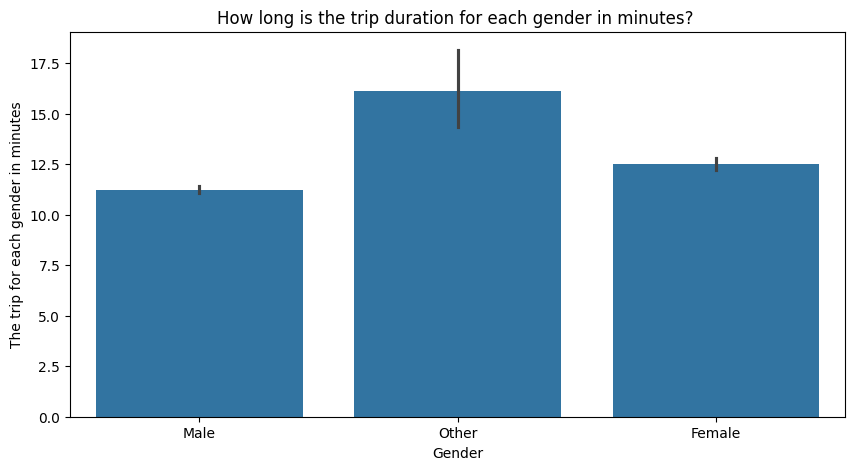

In [30]:
plt.figure(figsize = (10,5), dpi = 100)
sns.barplot(data = df, x = "member_gender", y = "duration_min")
plt.xlabel('Gender')
plt.ylabel('The trip for each gender in minutes')
plt.title("How long is the trip duration for each gender in minutes? ")
plt.show()

#### Male users have the lowest average trip durations of ~11 minutes as shown above

In [31]:
fig = px.box(
    df,
    x="member_gender",
    y="age",
    color="member_gender",  # optional: different colors per gender
    labels={
        "member_gender": "Gender",
        "age": "Ages"
    },
    title="Difference of ages according to gender"
)
fig.show()

## -------------------------------------------------------------
# Finally a multivariate analysis
#### which is the analysis of 3 or more variables together to see how they interact and influence each other

C:\Users\6y6yy\AppData\Local\Temp\ipykernel_5456\185672675.py:5: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



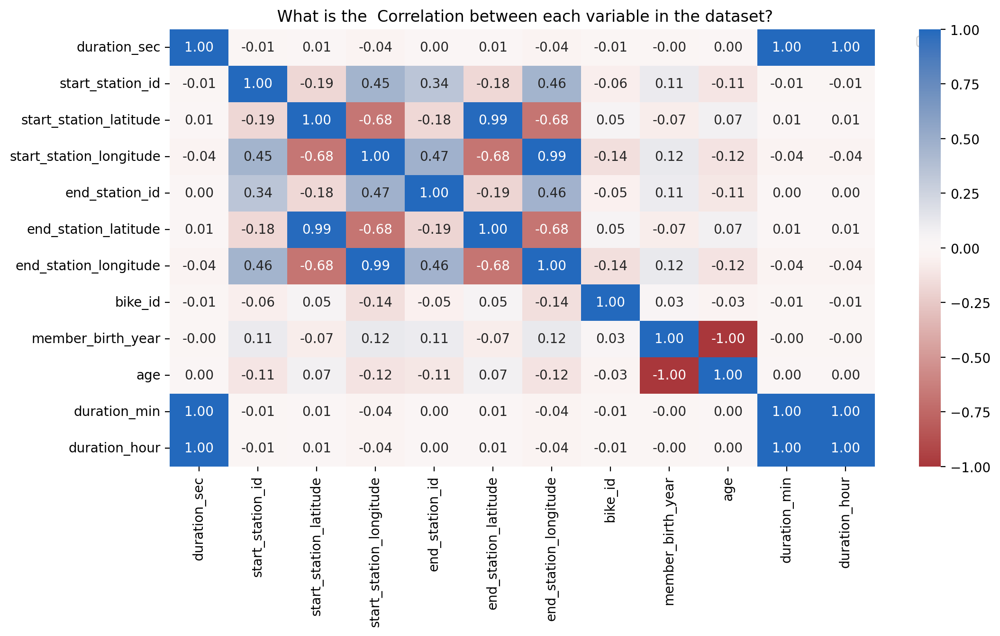

In [32]:
plt.figure(figsize = (12,6), dpi = 200)
sns.heatmap(df.select_dtypes(include='number').corr(), annot = True, fmt = '.2f', cmap = 'vlag_r', center = 0)
plt.title(" What is the  Correlation between each variable in the dataset?")
plt.xticks(rotation = 90)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

#### as seen above there is nearly no correlation at all between the variables "duration_sec","duration_min","duration_hour"

#### a strong correlation between "start_station_latitude","start_station_longitude" and "end_station_latitude","end_station_longitude"

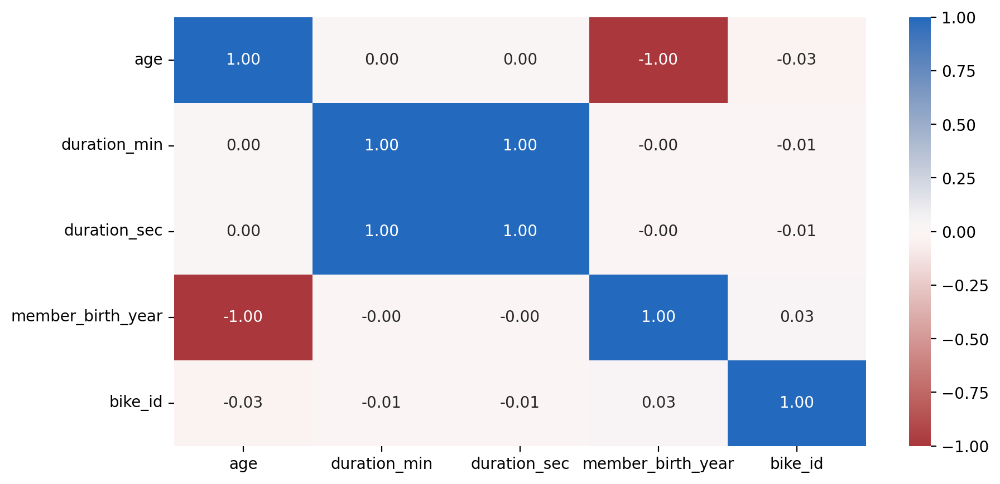

In [33]:
stats = ['age', 'duration_min',"duration_sec", "member_birth_year", "bike_id"]
plt.figure(figsize = (10,5), dpi = 200)
sns.heatmap(df[stats].corr(), annot = True, fmt = '.2f', cmap = 'vlag_r', center = 0);

#### Nearly no correlation again for time related variables like "duration_min" and "duration_sec"

#### negative correlation between "age" and "member_birth_year" which is understandable as they are mathematically reversed (age = current_year – member_birth_year)

## ------------------------------------------------------------
# Now lets start cleaning our Data, after our analysis is finished, we will spot the difference in our analysis before and after cleaning

In [34]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,age,duration_min,duration_hour,age_bin
0,52185,32:10.1,01:56.0,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No,35,869,14.50,"[30, 40)"
1,42521,53:21.8,42:03.1,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,1988.0,Male,No,31,708,11.81,"[30, 40)"
2,61854,13:13.2,24:08.1,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No,47,1030,17.18,"[40, 50)"
3,36490,54:26.0,02:36.8,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No,30,608,10.14,"[30, 40)"
4,1585,54:18.5,20:44.1,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes,45,26,0.44,"[40, 50)"


In [35]:
print("Duplicates:", df.duplicated().sum())
df = df.drop_duplicates()


Duplicates: 4


#### as done above, this will remove bias

In [36]:
df = df[(df['age'] >= 12) & (df['age'] <= 90)]

#### as implemented above, this will keep ages within reaslitic range

In [37]:
df = df.drop(columns=['start_time', 'end_time'])


#### dropping these columns as they arent really important since we already have the trip duration

In [38]:
df['member_gender'] = df['member_gender'].replace({
    'male': 'Male',
    'female': 'Female',
    'other': 'Other'
})

#### as shown above, this will achieve consistency 

In [39]:
df.info()
df.describe(include='all')

<class 'pandas.core.frame.DataFrame'>
Index: 183335 entries, 0 to 183411
Data columns (total 18 columns):
 #   Column                   Non-Null Count   Dtype   
---  ------                   --------------   -----   
 0   duration_sec             183335 non-null  int64   
 1   start_station_id         183335 non-null  float64 
 2   start_station_name       183335 non-null  object  
 3   start_station_latitude   183335 non-null  float64 
 4   start_station_longitude  183335 non-null  float64 
 5   end_station_id           183335 non-null  float64 
 6   end_station_name         183335 non-null  object  
 7   end_station_latitude     183335 non-null  float64 
 8   end_station_longitude    183335 non-null  float64 
 9   bike_id                  183335 non-null  int64   
 10  user_type                183335 non-null  object  
 11  member_birth_year        183335 non-null  float64 
 12  member_gender            183335 non-null  object  
 13  bike_share_for_all_trip  183335 non-null  object 

,duration_sec,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,age,duration_min,duration_hour,age_bin
count,183335.000000,183335.000000,183335,183335.000000,183335.000000,183335.000000,183335,183335.000000,183335.000000,183335.000000,183335,183335.000000,183335,183335,183335.000000,183335.000000,183335.000000,183335
unique,NaN,NaN,329,NaN,NaN,NaN,329,NaN,NaN,NaN,2,NaN,3,2,NaN,NaN,NaN,8
top,NaN,NaN,Market St at 10th St,NaN,NaN,NaN,San Francisco Caltrain Station 2 (Townsend St...,NaN,NaN,NaN,Subscriber,NaN,Male,No,NaN,NaN,NaN,"[30, 40)"
freq,NaN,NaN,4101,NaN,NaN,NaN,5051,NaN,NaN,NaN,163473,NaN,138855,166003,NaN,NaN,NaN,77367
mean,726.111806,138.483639,NaN,37.771210,-122.352662,136.174724,NaN,37.771414,-122.352249,4472.836223,NaN,1984.985311,NaN,NaN,34.014689,11.609938,0.201706,NaN
std,1794.741340,111.738867,NaN,0.099599,0.117111,111.476510,NaN,0.099507,0.116689,1664.406163,NaN,9.761477,NaN,NaN,9.761477,29.913932,0.498554,NaN
min,61.000000,3.000000,NaN,37.317298,-122.453705,3.000000,NaN,37.317298,-122.453705,11.000000,NaN,1930.000000,NaN,NaN,18.000000,1.000000,0.020000,NaN
25%,325.000000,47.000000,NaN,37.770083,-122.412408,44.000000,NaN,37.770407,-122.411726,3777.000000,NaN,1981.000000,NaN,NaN,27.000000,5.000000,0.090000,NaN
50%,514.000000,104.000000,NaN,37.780760,-122.398285,100.000000,NaN,37.781010,-122.398279,4957.000000,NaN,1988.000000,NaN,NaN,31.000000,8.000000,0.140000,NaN
75%,796.000000,239.000000,NaN,37.797280,-122.286533,235.000000,NaN,37.797320,-122.288045,5502.000000,NaN,1992.000000,NaN,NaN,38.000000,13.000000,0.220000,NaN


In [40]:
#remove trips longer than 6 hours (21,600 sec)
df = df[df['duration_sec'] <= 21600]


In [41]:
df['user_type'] = df['user_type'].str.strip().str.title()
#avoids mistakes like spacing or wrong capitalization

## Finally after cleaning our data we will start comparing between EDA from before cleaning our data and after


In [42]:
bins = range(11, 100, 8)  
labels = [f"{i}-{i+7}" for i in range(11, 99, 8)]

df['age_bin'] = pd.cut(df['age'], bins=bins, right=False, labels=labels)
df['age_bin'] = df['age_bin'].astype(str)

fig = px.histogram(
    df,
    x="age",
    color="age_bin",
    category_orders={"age_bin": labels},
    title="Customer's Age Distribution by Age Groups"
)
fig.show()


#### After cleaning, the bins give us a realistic picture of the true customer age distribution compared to the one before cleaning

In [43]:
fig = px.box(
    df,
    x="age",
    title="Represent the user's Age distribution"
)
fig.update_layout(
    xaxis_title="User Age distribution",
    yaxis_title="Frequency",
    template="plotly_white"
)
fig.show()

#### compared to the EDA before cleaning an this, the box isnt as compressed and the outliers arent as wide 

In [44]:
fig = px.box(
    df,
    x="user_type",
    y="age",
    title="Comparing between Customers and Subscribers according to their age",
    color="user_type"
)
fig.update_xaxes(title="User Type")
fig.update_yaxes(title="Age")
fig.update_layout(template="plotly_white")
fig.show()



#### as seen above in this Bivariate plot, wider spread with more younger riders and fewer older outliers than the EDA before cleaning

In [45]:
fig = px.box(
    df,
    x="member_gender",
    y="age",
    color="member_gender",  # optional: different colors per gender
    labels={
        "member_gender": "Gender",
        "age": "Ages"
    },
    title="Difference of ages according to gender"
)
fig.show()

#### in this Multivariate plot seen above, a wider spread and fewer unrealistic outliers than the one before cleaning

In [46]:
# check dtayps
dtypes = df.dtypes
nunique = df.nunique()
d = pd.DataFrame({"dtypes" : dtypes , "nunique" : nunique}).T
d

,duration_sec,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,age,duration_min,duration_hour,age_bin
dtypes,int64,float64,object,float64,float64,float64,object,float64,float64,int64,object,float64,object,object,int64,int64,float64,object
nunique,4555,329,329,334,335,329,329,335,335,4645,2,67,3,2,67,302,435,10


In [47]:
df.to_csv("test/cleaned_data.csv", index=False)